# Analysing Culture in Yelp Reviews

Ting Chen

In [1]:
import json

import re
import stanza

import numpy as np
from matplotlib import pyplot as plt

import nltk
import tomotopy as tp

from gensim import corpora, matutils
from sklearn.utils import shuffle
from sklearn import svm
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, confusion_matrix

from joblib import dump, load

from scipy import sparse

2021-05-19 00:21:38 WARNING: unable to import 'smart_open.gcs', disabling that module


## 1. Load in data

In [2]:
# Ethnic cuisines we have chosen to observe

classifier_keys = ['Chinese', 'American (Traditional)', 'Asian Fusion',
        'Italian', 'Mexican', 'Japanese','Indian', 'French']

In [17]:
# Load in reviews based on ethnicity from previous json dump

classifier_reviews = {}

with open('classifier_data.json', 'r') as file:
    classifier_reviews = json.load(file)

In [2]:
all_eth_reviews = {}

with open('all_eths_reviews.json', 'r') as file:
    all_eth_reviews = json.load(file)

In [4]:
all_eth_reviews['Chinese'][1]

{'review_id': 'QCxPzh7cuxJrLd6A_UTbpw',
 'user_id': 'qftVgPj_kRTildMDjwiqtg',
 'business_id': 'Ns4tjgLfqR1qawGlNFROBA',
 'stars': 5.0,
 'useful': 0,
 'funny': 0,
 'cool': 0,
 'text': 'Everything that my husband and I tried today was amazing. I am glad I got to try something different of what I normally would because i was really pleasantly surprised. We also order one sushi roll because we had to try at least one and we loved it! Definitely will be coming back to try more things. Place is really small, and there was only one server, but we came when it was really slow and the service was pretty fast. All in all very happy we got to try this place out.',
 'date': '2016-06-11 22:00:11'}

## figure out date range

In [5]:
dates = []
for key, value in all_eth_reviews.items():
    for val in value:
        dates.append(val['date'])

In [7]:
sort = sorted(dates)

In [8]:
sort[0]

'2004-10-12 10:13:32'

In [9]:
sort[-1]

'2019-12-13 15:43:16'

In [3]:
# down sample
too_small = []
for key, value in all_eth_reviews.items():
    if len(value) < 15000:
        too_small.append(key)

In [4]:
for key in too_small:
    del all_eth_reviews[key]

In [10]:
del all_eth_reviews['Canadian (New)']

In [8]:
del all_eth_reviews['Ethnic Food']

In [12]:
del all_eth_reviews['Asian Fusion']

In [7]:
del all_eth_reviews['Halal']

In [9]:
del all_eth_reviews['New Mexican Cuisine']

In [6]:
del all_eth_reviews['American (New)']

In [7]:
del all_eth_reviews['American (Traditional)']

In [8]:
del all_eth_reviews['Irish']

In [9]:
del all_eth_reviews['Cantonese']

In [23]:
sum([len(x) for x in all_eth_reviews.values()])

2941829

In [13]:
for key, value in all_eth_reviews.items():
    print(key + str(':'), len(value))

Canadian (New): 103655
Japanese: 379265
Middle Eastern: 85153
Brazilian: 21398
Italian: 470416
Hawaiian: 57018
Spanish: 29919
Cantonese: 20833
Pakistani: 33074
Greek: 87440
American (Traditional): 902047
Chinese: 314753
Caribbean: 36932
Irish: 24009
Indian: 93532
American (New): 881417
Korean: 117824
Lebanese: 16093
Mexican: 499055
Cajun/Creole: 47838
Thai: 160182
Tex-Mex: 73302
Taiwanese: 26625
German: 16385
Vietnamese: 108484
French: 117491
Filipino: 19941
British: 26054


In [14]:
len(all_eth_reviews.keys())

28

Save keys

In [25]:
with open('all_eths_minus_american_keys.json', 'w',encoding='utf-8') as outfile:
    json.dump(list(all_eth_reviews.keys()), outfile, ensure_ascii=False, indent=4)

Make this a ternary classification for now to speed up training and processing

In [18]:
ternary_keys = ['Chinese', 'Italian', 'Mexican']

In [19]:
ternary_reviews = {}

for key in ternary_keys:
    ternary_reviews[key] = classifier_reviews[key]

In [7]:
for key, value in ternary_reviews.items():
    print(key + str(':'), len(value))

Chinese: 202819
Italian: 415229
Mexican: 443937


## Find num of words and duplicates

In [10]:
for key, value in all_eth_reviews.items():
    print(key, sum([len(review['text'].split()) for review in value]))

Canadian (New) 13341244
Japanese 40303595
Middle Eastern 8114497
Brazilian 2496349
Italian 51235426
Hawaiian 5423578
Spanish 3927387
Cantonese 2242587
Pakistani 3318166
Greek 8327986
American (Traditional) 93815528
Chinese 32887851
Caribbean 3849622
Irish 2566136
Indian 9330176
American (New) 97858868
Korean 12762415
Lebanese 1407924
Mexican 46855021
Cajun/Creole 5301230
Thai 15882541
Tex-Mex 7181339
Taiwanese 2985473
German 1864581
Vietnamese 10725773
French 14966257
Filipino 2156824
British 2935425


In [11]:
reviews = []

for key, value in all_eth_reviews.items():
    for val in value:
        reviews.append(val['review_id'])

In [13]:
len(set(reviews))

3735232

Get locations for each review

In [20]:
businesses = []
for line in open('yelp_dataset/yelp_academic_dataset_business.json', 'r'):
    businesses.append(json.loads(line))

In [21]:
bus_table = {}

for bus in businesses:
    bus_table[bus['business_id']] = (bus['latitude'], bus['longitude'])

In [22]:
locations = []
for key, value in all_eth_reviews.items():
    for review in value:
        bus_id = review['business_id']
        locations.append(bus_table[bus_id])

In [23]:
len(locations) # All eths including american

4770135

In [24]:
len(set(locations))

35489

In [30]:
len(locations)

2941829

In [10]:
locations[1]

(33.3781389, -111.8613802)

In [31]:
locs = np.array(locations)

In [22]:
with open('locs_unshuffles.json', 'w',encoding='utf-8') as outfile:
    json.dump(locations, outfile, ensure_ascii=False, indent=4)

In [32]:
with open('locs_all_eths_minus_american.json', 'w',encoding='utf-8') as outfile:
    json.dump(locations, outfile, ensure_ascii=False, indent=4)

In [3]:
locs = []

with open('locs_all_eths_minus_american.json', 'r') as infile:
    locs = json.load(infile)

## Exploring geographic distribution of cuisines

In [14]:
all_eths = []

with open('all_eths.txt', 'r') as infile:
    all_eths = infile.read().split('\n')

In [16]:
all_eths= all_eths[:-1]

In [28]:
for eth in all_eths:
    locations = []

    for bus in businesses:
        if eth in str(bus['categories']):
            locations.append((bus['latitude'], bus['longitude']))
            
    world = geopandas.read_file(geopandas.datasets.get_path('naturalearth_lowres'))

    ax = world[world.continent == 'North America'].plot(
        color='white', edgecolor='black', figsize = (30, 30))


    df = pd.DataFrame(locations, columns= ['lat', 'long'])
    val = geopandas.GeoDataFrame(
    df, geometry=geopandas.points_from_xy(df.long, df.lat))

    val.plot(ax=ax, color='red', edgecolor='blue')

    plt.savefig('/Users/tingchen/Desktop/Yelp_Cultural_Analysis/lda/plots_eths/' + eth + '.png', bbox_inches='tight')
    plt.close()

In [ ]:
gdf_regions = {}

for key in regions_locs.keys():
    df = pd.DataFrame(regions_locs[key], columns= ['lat', 'long'])
    gdf_regions[key] = geopandas.GeoDataFrame(
    df, geometry=geopandas.points_from_xy(df.long, df.lat))

In [6]:
len(locations)

32

In [15]:
import pandas as pd
import geopandas
import matplotlib.pyplot as plt

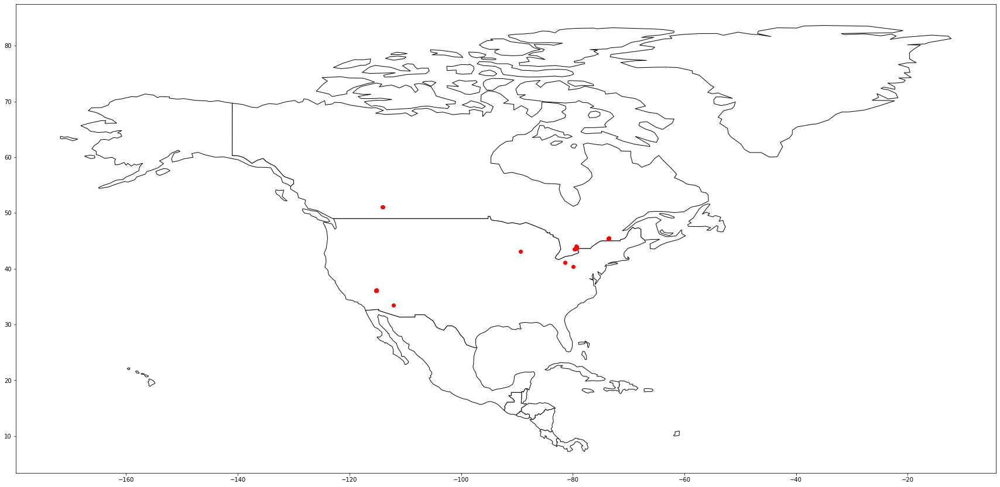

In [13]:
world = geopandas.read_file(geopandas.datasets.get_path('naturalearth_lowres'))

ax = world[world.continent == 'North America'].plot(
    color='white', edgecolor='black', figsize = (30, 30))


colors= ['red', 'blue', 'green', 'purple', 'orange' ] #, 'yellow', 'pink', 'grey', 'brown', 'black']

df = pd.DataFrame(locations, columns= ['lat', 'long'])
val = geopandas.GeoDataFrame(
df, geometry=geopandas.points_from_xy(df.long, df.lat))

val.plot(ax=ax, color=colors[0])

plt.show()

## 2. Preprocess

Example review text:

In [8]:
ternary_reviews['Mexican'][233]

{'review_id': 'GHG86K-5dAIxBIsZVNqLjA',
 'user_id': '2-XLTj0Cfd81_XlmHo02Aw',
 'business_id': 'P8IsTiHq5Hesa6UPL604ww',
 'stars': 5.0,
 'useful': 1,
 'funny': 0,
 'cool': 0,
 'text': "Another visit to one of my favorite lunch-time haunts with my Zach. Can't stop trying the nachos, but have also branched out and tried the lengua tacos (yum) and some of the other specialties on the menu. I haven't been disappointed yet, and the place is always packed at lunchtime. So much better than most of the fast Mexican places out there and quite good prices. Once a week is not enough :).",
 'date': '2012-09-10 17:30:36'}

For now best results are nltk tokenized and punctation removed

In [20]:
stopwords = set(nltk.corpus.stopwords.words('english'))

classifier_text = {k:[] for k in ternary_keys}

for key, value in ternary_reviews.items():
    print(key)
    for i in range(int(len(value))):
        if i % 10000 == 0:
            print(i)
            
        doc = nltk.tokenize.word_tokenize(ternary_reviews[key][i]['text'])
        
        text = [token for token in doc if re.match("[a-zA-Z0-9']+", token)]
        
        classifier_text[key].append([w.lower() for w in text if w not in stopwords])

NameError: name 'ternary_keys' is not defined

In [15]:
stopwords = set(nltk.corpus.stopwords.words('english'))

all_eths_text = {k:[] for k in all_eth_reviews.keys()}

for key, value in all_eth_reviews.items():
    print(key)
    for i in range(int(len(value))):
        if i % 10000 == 0:
            print("\r" + str(i), end="")
            
        doc = nltk.tokenize.word_tokenize(all_eth_reviews[key][i]['text'])
        
        text = [token for token in doc if re.match("[a-zA-Z0-9']+", token)]
        
        all_eths_text[key].append([w.lower() for w in text if w not in stopwords])
    print("")

Canadian (New)
100000
Japanese
370000
Middle Eastern
80000
Brazilian
20000
Italian
470000
Hawaiian
50000
Spanish
20000
Cantonese
20000
Pakistani
30000
Greek
80000
American (Traditional)
900000
Chinese
310000
Caribbean
30000
Irish
20000
Indian
90000
American (New)
880000
Korean
110000
Lebanese
10000
Mexican
490000
Cajun/Creole
40000
Thai
160000
Tex-Mex
70000
Taiwanese
20000
German
10000
Vietnamese
100000
French
110000
Filipino
10000
British
20000


After removing proper nouns using Stanford POS tagger and removing punctuation we see:

In [148]:
cleaned = [word.text for sent in doc.sentences for word in sent.words if word.upos != 'PROPN']
cleaned

['Another',
 'visit',
 'to',
 'one',
 'of',
 'my',
 'favorite',
 'lunch',
 '-',
 'time',
 'haunts',
 'with',
 'my',
 '.',
 'Ca',
 "n't",
 'stop',
 'trying',
 'the',
 'nachos',
 ',',
 'but',
 'have',
 'also',
 'branched',
 'out',
 'and',
 'tried',
 'the',
 'lengua',
 'tacos',
 '(',
 'yum',
 ')',
 'and',
 'some',
 'of',
 'the',
 'other',
 'specialties',
 'on',
 'the',
 'menu',
 '.',
 'I',
 'have',
 "n't",
 'been',
 'disappointed',
 'yet',
 ',',
 'and',
 'the',
 'place',
 'is',
 'always',
 'packed',
 'at',
 'lunchtime',
 '.',
 'So',
 'much',
 'better',
 'than',
 'most',
 'of',
 'the',
 'fast',
 'Mexican',
 'places',
 'out',
 'there',
 'and',
 'quite',
 'good',
 'prices',
 '.',
 'Once',
 'a',
 'week',
 'is',
 'not',
 'enough',
 ':)',
 '.']

In [150]:
[token for token in cleaned if re.match("[a-zA-Z0-9']+", token)]

['Another',
 'visit',
 'to',
 'one',
 'of',
 'my',
 'favorite',
 'lunch',
 'time',
 'haunts',
 'with',
 'my',
 'Ca',
 "n't",
 'stop',
 'trying',
 'the',
 'nachos',
 'but',
 'have',
 'also',
 'branched',
 'out',
 'and',
 'tried',
 'the',
 'lengua',
 'tacos',
 'yum',
 'and',
 'some',
 'of',
 'the',
 'other',
 'specialties',
 'on',
 'the',
 'menu',
 'I',
 'have',
 "n't",
 'been',
 'disappointed',
 'yet',
 'and',
 'the',
 'place',
 'is',
 'always',
 'packed',
 'at',
 'lunchtime',
 'So',
 'much',
 'better',
 'than',
 'most',
 'of',
 'the',
 'fast',
 'Mexican',
 'places',
 'out',
 'there',
 'and',
 'quite',
 'good',
 'prices',
 'Once',
 'a',
 'week',
 'is',
 'not',
 'enough']

Repeating this process for the whole dataset as well as removing stopwords,

In [151]:
stopwords = set(nltk.corpus.stopwords.words('english'))

classifier_text = {k:[] for k in ternary_keys}

for key, value in ternary_reviews.items():
    print(key)
    for i in range(int(len(value))):
        if i % 1000 == 0:
            print(i)
            
        doc = nlp(ternary_reviews[key][i]['text'])
        
        cleaned = [word.text for sent in doc.sentences for word in sent.words if word.upos != 'PROPN']
        text = [token for token in cleaned if re.match("[a-zA-Z0-9']+", token)]
        
        classifier_text[key].append([w.lower() for w in text if w not in stopwords])

Chinese
0
1000
2000
3000
4000
5000
6000
7000
8000
9000
10000
11000
12000
13000
14000
15000
16000
17000
18000
19000
20000
21000
22000
23000
24000
25000
26000
27000
28000
29000
30000
31000
32000
33000
34000
35000
36000
37000
38000
39000
40000
41000
42000
43000
44000
45000
46000
47000
48000
49000
50000
51000
52000
53000
54000
55000
56000
57000
58000
59000
60000
61000
62000
63000
64000
65000
66000
67000
68000
69000
70000
71000
72000
73000
74000
75000
76000
77000
78000
79000
80000
81000
82000
83000
84000
85000
86000
87000
88000
89000
90000
91000
92000
93000
94000
95000
96000
97000
98000
99000
100000
101000
102000
103000
104000
105000
106000
107000
108000
109000
110000
111000
112000
113000
114000
115000


KeyboardInterrupt: 

Save our tokenized reviews as json for future use

In [8]:
with open('nltk_tokenized_punc_removed_reviews.json', 'w',encoding='utf-8') as outfile:
    json.dump(classifier_text, outfile, ensure_ascii=False, indent=4)

In [34]:
with open('nltk_tokenized_punc_removed_all_eths_minus_american_reviews.json', 'w',encoding='utf-8') as outfile:
    json.dump(all_eths_text, outfile, ensure_ascii=False, indent=4)

In [16]:
with open('nltk_tokenized_punc_removed_all_eths_reviews.json', 'w',encoding='utf-8') as outfile:
    json.dump(all_eths_text, outfile, ensure_ascii=False, indent=4)

In [19]:
all_eths_text['Chinese'][5]

['after',
 'regular',
 'veggie',
 'house',
 'thought',
 'cool',
 'try',
 'chef',
 'kenny',
 "'s",
 'we',
 'went',
 'couple',
 'times',
 'usually',
 'great',
 'experience',
 'recently',
 'ordered',
 'spicy',
 'crispy',
 'beef',
 'came',
 'cold',
 'told',
 'waitress',
 'all',
 'bring',
 'hotter',
 'rice',
 'pretend',
 'hear',
 'request',
 'i',
 'called',
 'back',
 'share',
 'experience',
 'shock',
 'they',
 'actually',
 'put',
 'chef',
 'kenny',
 'phone',
 'at',
 'first',
 'i',
 'thought',
 'cool',
 'completely',
 'different',
 'i',
 'expected',
 'instead',
 'understanding',
 'owner',
 'rude',
 'told',
 'next',
 'time',
 'i',
 'come',
 'happens',
 'let',
 'know',
 "'s",
 "'s",
 'nothing',
 'already',
 'left',
 'i',
 "'m",
 'sorry',
 'next',
 'time',
 'i',
 "'m",
 'going',
 'back',
 'veggie',
 'house',
 'treat',
 'customers',
 'respect',
 'i',
 'also',
 'unfollowed',
 'chef',
 'kenny',
 'instagram',
 'well']

## 3. Topic Modeling

Use the tomotopy library to perform LDA and MG-LDA on our dataset. Runs faster and easier to filter out words than gensim. Remove top 20 words and use 40 topics.

In [ ]:
models = {}
numTopics = 40
numRemove = 20

for key in ternary_keys:
    models[key] = tp.LDAModel(k=numTopics, rm_top=numRemove)

*Tuning area, to be deleted later*

In [10]:
eth = 'Chinese'

for review in classifier_text[eth]:
    models[eth].add_doc(review)
    
for i in range(0, 100, 10):
    models[eth].train(10)
    print('Iteration: {}\tLog-likelihood: {}'.format(i, models[eth].ll_per_word))
    
# 40 topics

for k in range(models[eth].k):
    print('Top 10 words of topic #{}'.format(k))
    print(models[eth].get_topic_words(k, top_n=10))

Iteration: 0	Log-likelihood: -10.133991045373033
Iteration: 10	Log-likelihood: -9.533200301128364
Iteration: 20	Log-likelihood: -9.235206036273006
Iteration: 30	Log-likelihood: -9.06813290338416
Iteration: 40	Log-likelihood: -8.969995805502544
Iteration: 50	Log-likelihood: -8.90679198327805
Iteration: 60	Log-likelihood: -8.863249020034662
Iteration: 70	Log-likelihood: -8.831381252734639
Iteration: 80	Log-likelihood: -8.807492448158156
Iteration: 90	Log-likelihood: -8.7897693112847
Top 10 words of topic #0
[('sauce', 0.036666955798864365), ('--', 0.025386963039636612), ('dish', 0.025256123393774033), ('spicy', 0.024558309465646744), ('tofu', 0.014796853996813297), ('noodles', 0.011458451859652996), ('ordered', 0.011038177646696568), ('flavor', 0.010043000802397728), ('bean', 0.009928019717335701), ('chili', 0.009587042964994907)]
Top 10 words of topic #1
[('lobster', 0.028722019866108894), ('duck', 0.02449153922498226), ('fish', 0.017485711723566055), ('seafood', 0.015288560651242733), 

Observe above that sometimes we get punctuation in topics

## 4. Classifiers

Create lexicons for bow representations of data using gensim

In [3]:
classifier_text = {}

with open('nltk_tokenized_punc_removed_reviews.json', 'r') as infile:
    classifier_text =json.load(infile)

In [ ]:
all_eths_text = {}

with open('nltk_tokenized_punc_removed_all_eths_minus_american_reviews.json', 'r') as infile:
    all_eths_text =json.load(infile)

In [20]:
lexicons = {k:{} for k in ternary_keys}
big_lexicon = corpora.Dictionary({})

for k in lexicons.keys():
    lexicons[k] = corpora.Dictionary(classifier_text[k])
    
for lexicon in lexicons.values():
    big_lexicon.merge_with(lexicon)

NameError: name 'ternary_keys' is not defined

In [21]:
lexicons = {k:{} for k in all_eths_text.keys()}
big_lexicon = corpora.Dictionary({})

for k in lexicons.keys():
    lexicons[k] = corpora.Dictionary(all_eths_text[k])
    
for lexicon in lexicons.values():
    big_lexicon.merge_with(lexicon)

In [36]:
big_lexicon = corpora.Dictionary.load("big_lexicon_n_20_removed_all_eths_may_2021")

In [22]:
big_lexicon.filter_n_most_frequent(20)

In [23]:
big_lexicon.save("big_lexicon_n_20_removed_all_eths_may_2021")

In [8]:
big_lexicon.save("big_lexicon_n_20_removed")

In [ ]:
big_lexicon.save("big_lexicon_n_20_removed_all_eths_minus_american")

In [24]:
big_lexicon.save("big_lexicon")

In [38]:
big_lexicon.filter_extremes(no_below=2, no_above=1.0, keep_n=None)

In [39]:
len(list(big_lexicon.token2id.keys()))

421337

In [40]:
big_lexicon.save("big_lexicon_n_20_removed_all_eths_no_below_2")

In [ ]:
big_bows = []

for k in all_eths_text.keys():
    for review in all_eths_text[k]:
        big_bows.append(big_lexicon.doc2bow(review))

Save bows to json

In [14]:
with open('big_bows_nltk_tokenized_punc_removed.json', 'w',encoding='utf-8') as outfile:
    json.dump(big_bows, outfile, ensure_ascii=False, indent=4)

In [11]:
with open('big_bows_nltk_tokenized_punc_removed_n20_removed.json', 'w',encoding='utf-8') as outfile:
    json.dump(big_bows, outfile, ensure_ascii=False, indent=4)

In [66]:
with open('big_bows_nltk_tokenized_punc_removed_n20_removed_all_eths.json', 'w',encoding='utf-8') as outfile:
    json.dump(big_bows, outfile, ensure_ascii=False, indent=4)

Create data to feed into classifiers

In [14]:
big_bows = []
with open('big_bows_nltk_tokenized_punc_removed.json', 'r') as file:
    big_bows = json.load(file)

In [6]:
big_bows = []
with open('big_bows_nltk_tokenized_punc_removed_n20_removed.json', 'r') as file:
    big_bows = json.load(file)

KeyboardInterrupt: 

In [67]:
len(big_bows)

1066736

In [ ]:
y_vals = np.array([[0]*len(classifier_text['Chinese']) + [1]*len(classifier_text['American (Traditional)']) + [2]*len(classifier_text['Asian Fusion'])
                    +[3]*len(classifier_text['Italian']) + [4]*len(classifier_text['Mexican']) + [5]*len(classifier_text['Japanese'])  
                    +[6]*len(classifier_text['Indian']) + [7]*len(classifier_text['French'])])

big_tf_array = matutils.corpus2csc(big_bows)

In [4]:
y_vals = np.array([[0]*202819 + [1]* 806830 + [2]*111310 
                    +[3]* 415229 + [4]* 443937 + [5]*253150  
                    +[6]*84297 + [7]*97172])

big_tf_array = matutils.corpus2csc(big_bows)

In [ ]:
vals = []

for i, value in enumerate(all_eths_text.values()):
    vals += ([i] * len(value))

y_vals = np.array(vals)

big_tf_array = matutils.corpus2csc(big_bows)

In [22]:
import lda
import numpy as np

In [45]:
sparse.save_npz('./big_tf_array_all_eths_minus_american.npz', big_tf_array)

Ternary reviews data set up

In [10]:
y_vals = np.array([[0]*202819 + [1]* 415229+ [2]*443937])

big_tf_array = matutils.corpus2csc(big_bows)

In [5]:
y_vals = np.array([[0]*103655 + [1]*379265 + [2]*85153 + [3]*21398 + [4]*470416 + [5]*57018 + [6] *29919 + [7]*33074 + [8]*87440 + [9]*314753 +[10]*36932 +[11]*93532 +[12]*117824 +[13]*16093 +[14]*499055+[15]*47838 +[16]*160182 + [17]*73302 + [18]*26625 +[19]*16385+ [20]*108484 + [21]*117491 +[22]*19941 +[23]*26054])

In [2]:
big_tf_array = sparse.load_npz('./big_tf_array_all_eths_minus_american.npz')

Shuffle data using sklearn method

In [6]:
big_tf_array, y_vals, locs = shuffle(big_tf_array.transpose(), y_vals.transpose(), locs)

Split data using 70-15-15 split

In [75]:
# why two indicies?

index_stop_first = int((.7*y_vals.shape[0]))
index_stop_second = int((.85*y_vals.shape[0]))


X_train = big_tf_array[:index_stop_first, :]
y_train = y_vals[:index_stop_first, :].ravel()
locs_train = locs[:index_stop_first] 
N_train = y_train.size


X_val = big_tf_array[index_stop_first:index_stop_second, :]
y_val = y_vals[index_stop_first:index_stop_second, :]
locs_val = locs[index_stop_first:index_stop_second] 
N_val = y_val.size

X_test = big_tf_array[index_stop_second:, :]
y_test = y_vals[index_stop_second:, :]
locs_test = locs[index_stop_second:]
N_test = y_test.size

IndexError: too many indices for array

In [7]:
index_stop_first = int((.7*y_vals.shape[0]))
index_stop_second = int((.85*y_vals.shape[0]))


X_train = big_tf_array[:index_stop_first, :]
y_train = y_vals[:index_stop_first]
locs_train = locs[:index_stop_first] 
N_train = y_train.size


X_val = big_tf_array[index_stop_first:index_stop_second, :]
y_val = y_vals[index_stop_first:index_stop_second]
locs_val = locs[index_stop_first:index_stop_second] 
N_val = y_val.size

X_test = big_tf_array[index_stop_second:, :]
y_test = y_vals[index_stop_second:]
locs_test = locs[index_stop_second:]
N_test = y_test.size

Save data for future use

In [8]:
from scipy import sparse

In [ ]:
sparse.save_npz('./data_n_20_removed_all_eths/X_train.npz', X_train)
#sparse.save_npz('./data/y_train.npz', y_train)
sparse.save_npz('./data_n_20_removed_all_eths/X_val.npz', X_val)
#sparse.save_npz('./data/y_val.npz', y_val)
sparse.save_npz('./data_n_20_removed_all_eths/X_test.npz', X_test)
#sparse.save_npz('./data/y_test.npz', y_test)

In [14]:
sparse.save_npz('./data_n_20_removed_all_eths_less_than_15000/X_train.npz', X_train)
#sparse.save_npz('./data/y_train.npz', y_train)
sparse.save_npz('./data_n_20_removed_all_eths_less_than_15000/X_val.npz', X_val)
#sparse.save_npz('./data/y_val.npz', y_val)
sparse.save_npz('./data_n_20_removed_all_eths_less_than_15000/X_test.npz', X_test)
#sparse.save_npz('./data/y_test.npz', y_test)

In [9]:
sparse.save_npz('./data_n_20_removed_all_eths_minus_american/X_train.npz', X_train)
#sparse.save_npz('./data/y_train.npz', y_train)
sparse.save_npz('./data_n_20_removed_all_eths_minus_american/X_val.npz', X_val)
#sparse.save_npz('./data/y_val.npz', y_val)
sparse.save_npz('./data_n_20_removed_all_eths_minus_american/X_test.npz', X_test)
#sparse.save_npz('./data/y_test.npz', y_t

This stuff causes python to crash when reloading data

In [15]:
np.save("./data_n_20_removed_all_eths_less_than_15000/y_train.npy", y_train)
#np.save("./data/X_val.npy", X_val)
np.save("./data_n_20_removed_all_eths_less_than_15000/y_val.npy", y_val)
#np.save("./data/X_test.npy", X_test)
np.save("./data_n_20_removed_all_eths_less_than_15000/y_test.npy", y_test)

In [10]:
np.save("./data_n_20_removed_all_eths_minus_american/y_train.npy", y_train)
#np.save("./data/X_val.npy", X_val)
np.save("./data_n_20_removed_all_eths_minus_american/y_val.npy", y_val)
#np.save("./data/X_test.npy", X_test)
np.save("./data_n_20_removed_all_eths_minus_american/y_test.npy", y_test)

In [23]:
np.load("./data/y_train.npy")

array([1, 1, 1, ..., 2, 1, 1])

In [15]:
with open('./data_n_20_removed_all_eths_minus_american/locs_train.json', 'w',encoding='utf-8') as outfile:
    json.dump(locs_train, outfile, ensure_ascii=False, indent=4)

with open('./data_n_20_removed_all_eths_minus_american/locs_val.json', 'w',encoding='utf-8') as outfile:
    json.dump(locs_val, outfile, ensure_ascii=False, indent=4)

with open('./data_n_20_removed_all_eths_minus_american/locs_test.json', 'w',encoding='utf-8') as outfile:
    json.dump(locs_test, outfile, ensure_ascii=False, indent=4)

### Train SVM with linear kernel

In [ ]:
clf = svm.LinearSVC(dual=False)
clf.fit(X_train, y_train)

y_pred_train = clf.predict(X_train)

In [ ]:
dump(clf, 'svm-normalparams-propNs_removed%.joblib') 

Evaluate and print classification report for training set

In [40]:
print(classification_report(y_train, y_pred_train))

              precision    recall  f1-score   support

           0       0.91      0.85      0.88    141951
           1       0.79      0.94      0.86    564868
           2       0.89      0.62      0.73     77678
           3       0.92      0.83      0.87    290680
           4       0.94      0.87      0.90    310647
           5       0.93      0.88      0.90    177374
           6       0.97      0.90      0.93     59271
           7       0.92      0.77      0.84     67851

    accuracy                           0.87   1690320
   macro avg       0.91      0.83      0.86   1690320
weighted avg       0.88      0.87      0.87   1690320



Evaluate and print classification report for validation set

In [41]:
print(classification_report(y_val, clf.predict(X_val)))

              precision    recall  f1-score   support

           0       0.83      0.76      0.79     30497
           1       0.73      0.89      0.80    120668
           2       0.70      0.44      0.54     16805
           3       0.85      0.76      0.80     62520
           4       0.89      0.82      0.85     66598
           5       0.87      0.82      0.84     37819
           6       0.91      0.82      0.87     12570
           7       0.78      0.62      0.69     14735

    accuracy                           0.80    362212
   macro avg       0.82      0.74      0.77    362212
weighted avg       0.81      0.80      0.80    362212



Let's look at the weights for each cuisine type classifier

#### Chinese food:

In [42]:
vals = list(zip(big_lexicon.values(), clf.coef_[0, :]))

for x in sorted(vals, key=lambda x: x[1], reverse=True):
    if x[1] != 0:
        print("{0:15s} => {1: 8.2f}".format(x[0], x[1]))

entree-wise     =>     3.02
northwood       =>     3.01
pooched         =>     2.97
7steak          =>     2.92
'huevos         =>     2.68
borough         =>     2.65
classical-royal =>     2.62
ordeal-she      =>     2.61
warmth-that     =>     2.58
mahjong         =>     2.49
devasted        =>     2.49
califorina      =>     2.48
condensation-   =>     2.47
barese          =>     2.44
diy-style       =>     2.44
schnucks        =>     2.44
service/location =>     2.44
7777            =>     2.43
yourkshire      =>     2.40
birdseye        =>     2.36
w/card          =>     2.35
carny-ass       =>     2.35
yakimandu       =>     2.31
drag-           =>     2.28
landology       =>     2.27
american/bbq    =>     2.24
amforgiving     =>     2.24
middle/thickest =>     2.23
ginbu           =>     2.22
profusion       =>     2.20
bernadus        =>     2.17
under-baked     =>     2.15
bruleé          =>     2.14
12-inch         =>     2.14
oeb             =>     2.12
halfway-full    => 

### Train Logistic Regression

Use same liblinear library for logistic regression

In [ ]:
logit = LogisticRegression(solver='liblinear')
logit.fit(X_train, y_train)

y_pred_train_logit = logit.predict(X_train)

Evaluate and print classification report for training set

In [33]:
print(classification_report(y_train, y_pred_train_logit))

              precision    recall  f1-score   support

           0       0.89      0.81      0.85    141951
           1       0.76      0.93      0.84    564868
           2       0.85      0.52      0.65     77678
           3       0.90      0.81      0.85    290680
           4       0.93      0.85      0.89    310647
           5       0.91      0.86      0.88    177374
           6       0.96      0.86      0.91     59271
           7       0.89      0.69      0.78     67851

    accuracy                           0.85   1690320
   macro avg       0.89      0.79      0.83   1690320
weighted avg       0.86      0.85      0.85   1690320



Evaluate and print classification report for validation set

In [34]:
print(classification_report(y_val, logit.predict(X_val)))

              precision    recall  f1-score   support

           0       0.84      0.77      0.80     30497
           1       0.73      0.91      0.81    120668
           2       0.75      0.43      0.55     16805
           3       0.86      0.77      0.81     62520
           4       0.90      0.82      0.86     66598
           5       0.88      0.82      0.85     37819
           6       0.93      0.82      0.87     12570
           7       0.82      0.61      0.70     14735

    accuracy                           0.81    362212
   macro avg       0.84      0.74      0.78    362212
weighted avg       0.82      0.81      0.81    362212



Let's look at the weights for each cuisine type classifier

#### Chinese Food:

In [37]:
vals = list(zip(big_lexicon.values(), logit.coef_[0, :]))

for x in sorted(vals, key=lambda x: x[1], reverse=True):
    if x[1] != 0:
        print("{0:15s} => {1: 8.2f}".format(x[0], x[1]))

northwood       =>     6.40
binion          =>     5.87
natt            =>     5.34
spil            =>     4.95
ginbu           =>     4.81
hakkasan        =>     4.71
binions         =>     4.68
borough         =>     4.63
tiesto          =>     4.22
dimsum          =>     4.03
gata            =>     3.92
mahjong         =>     3.86
aoki            =>     3.78
diver           =>     3.74
congee          =>     3.63
panda           =>     3.53
7777            =>     3.48
pandas          =>     3.40
chengdu         =>     3.38
lillie          =>     3.37
beijing         =>     3.32
osha            =>     3.32
american-chinese =>     3.31
hao             =>     3.30
generals        =>     3.30
akabane         =>     3.30
chinese         =>     3.22
ports           =>     3.20
szechuan        =>     3.17
kenny           =>     3.16
china           =>     3.15
mott            =>     3.15
hunan           =>     3.13
hk-style        =>     3.13
yunnan          =>     3.07
wechat          => 